## Imports

In [1]:
import pandas as pd
import itertools
import networkx as nx
import graphistry
import folium
from folium.plugins import MarkerCluster
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from wordcloud import WordCloud
from PIL import Image
from matplotlib.colors import ListedColormap
import re
from sklearn.metrics.cluster import silhouette_score
from sklearn.preprocessing import scale, robust_scale
from sklearn.cluster import KMeans
import json
from networkx.algorithms import bipartite
from sklearn.cluster import SpectralClustering
from matplotlib.colors import ListedColormap
import numpy as np
import operator
from os import path, getcwd
import community
import networkx as nx
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

### Load Data

In [2]:
data = pd.read_csv('gtd.csv',encoding = 'latin_1')

### Data cleaning

In [3]:
data.head(5)

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


Since we noticed that the dataframe contains too many features and too many null values we decided to check the number of misisng values per feature.

In [4]:
# select only the columns with missing values > 0.5 
columns = data.columns
percent_missing = data.isnull().sum() * 100 / len(data)
missing_value_df = pd.DataFrame({'column_name': columns,
                                 'percent_missing': percent_missing})
print('Percentage of missing values per feature: ')
missing_value_df.sort_values(by = 'percent_missing',ascending = False).head()

Percentage of missing values per feature: 


,column_name,percent_missing
gsubname3,gsubname3,99.988992
weapsubtype4_txt,weapsubtype4_txt,99.961473
weapsubtype4,weapsubtype4,99.961473
weaptype4,weaptype4,99.959822
weaptype4_txt,weaptype4_txt,99.959822


We decided to delete all features where the percentage of missing values is less than 50%.

In [5]:
cols = list(missing_value_df[missing_value_df['percent_missing']<0.5].index)
cols.append('related')
new_data = data[cols]

Correlations between features

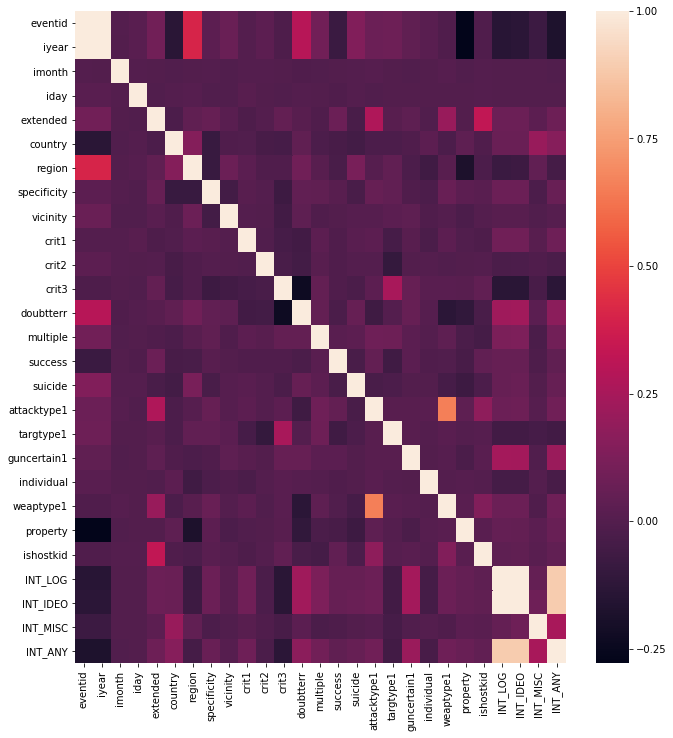

In [6]:
#plot the correlations between features
plt.figure(figsize=(11,12))
sns.heatmap(new_data.corr())

### Exploratory analysis

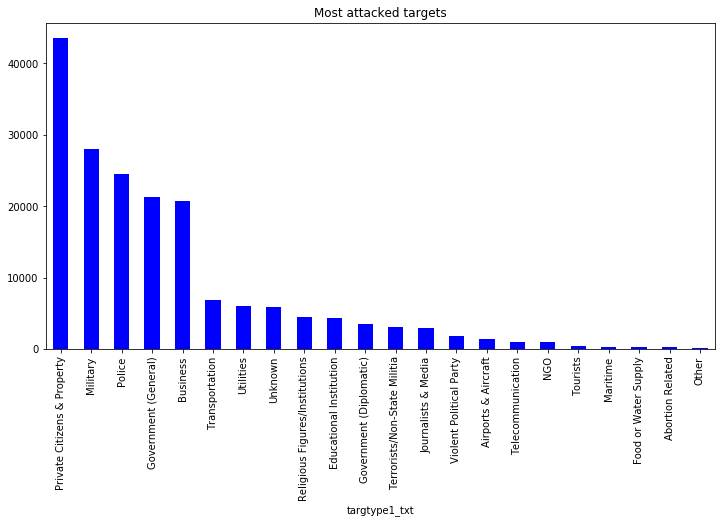

In [7]:
#select the most attacked targets
new_data.groupby('targtype1_txt').count()['eventid'].sort_values(ascending = False).head(40).plot.bar(
    title='Most attacked targets', figsize=(12, 6),color = 'b'
)

### Data vaisualization

Evolution of the number of attacks since 1970:

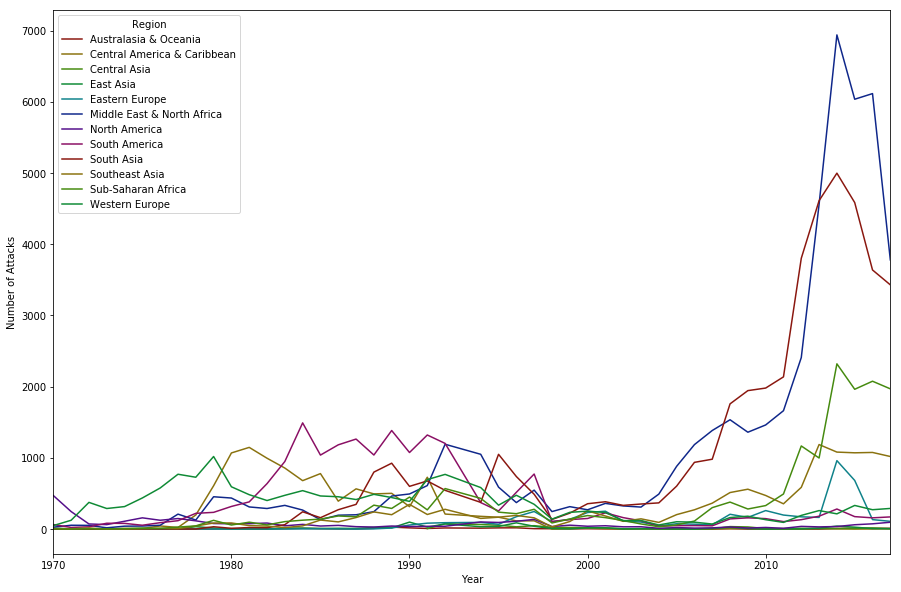

In [8]:
# method that counts the number of attacks per year per region.
def attacks_region(data):
    plt.subplots(figsize=(15,10))
    d = data.groupby(['region_txt','iyear'])['iyear'].count()
    d = pd.DataFrame(d)
    d.reset_index(level=0,inplace=True)
    d.columns = ['Region','Number of Attacks']
    d.reset_index(level=0,inplace=True)
    d['dummy']=0
    t = sns.tsplot(time='iyear',value='Number of Attacks',condition='Region',data=d,unit='dummy',color = sns.hls_palette(8, l=.3, s=.8))
    t.set_xlabel("Year")
    plt.show()

attacks_region(data)


We wanted to plot for a specific year how many attacks have been made per region

In [9]:
# we need to filter on the year
filterYear = data['iyear'] == 1975 
filterData = data[filterYear] # filter data
# get the needed columns
reqFilterData = filterData.loc[:,'city':'longitude'] 
reqFilterData = reqFilterData.dropna() # drop NaN values in latitude and longitude
reqFilterDataList = reqFilterData.values.tolist()
#draw the map
map_ = folium.Map(location = [0, 30], tiles='CartoDB positron', zoom_start=2)
markerCluster = folium.plugins.MarkerCluster().add_to(map_)
for point in range(0, len(reqFilterDataList)):
    folium.Marker(location=[reqFilterDataList[point][1],reqFilterDataList[point][2]], popup = reqFilterDataList[point][0]).add_to(markerCluster)
map_

###  number of attacks in  2016 by country

In [10]:
def stats(data):
    plt.subplots(figsize=(10,10))
    d = pd.DataFrame(data[data['iyear']==2016]['country_txt'].value_counts(sort=True)[:10])
    d.reset_index(inplace=True)
    d.columns=['country','no_of_attacks']
    append = ['Rest of the world',sum(data[data['iyear']==2016]['country_txt'].value_counts(sort=True)) - sum(data[data['iyear']==2016]['country_txt'].value_counts(sort=True)[:10])]
    plt.title("Percentage of attacks in each country")
    plt.pie(d['no_of_attacks'],labels=d['country'],colors= sns.hls_palette(8, l=.3, s=.8),autopct='%.1f%%')
    plt.show()

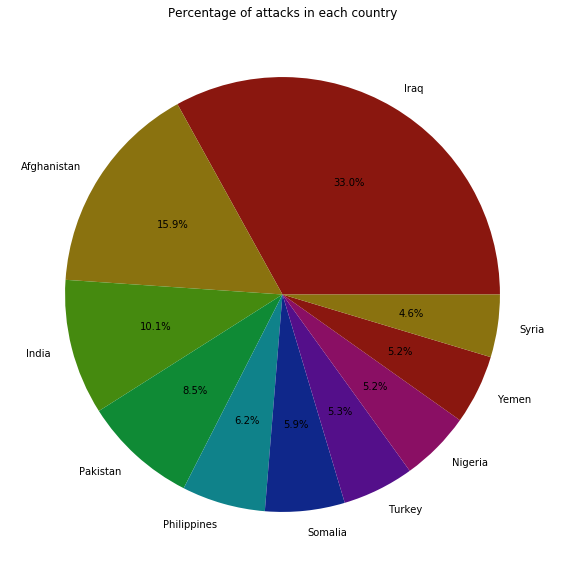

In [11]:
stats(data)

### Taking a deeper look on the effect of terrorist attacks per country.

In [12]:
# Number of kills per country
count_nb_kills = data.groupby('country_txt').sum()['nkill'].reset_index()
count_nb_kills.rename({'nkill':'count'},axis = 1,inplace = True)
count_nb_kills = count_nb_kills.replace(np.nan,0)

# Load the geojson
geo_json = json.load(open('world_heavy.json'))

# Read country code file to join our dataframe to corresponding country codes
countries_codes = pd.read_csv('countries_countriesCode.csv',header=None)
countries_codes['index'] = countries_codes.iloc[:,1]
countries_codes['folium_index'] =  countries_codes.iloc[:,0]
countries_codes['countries'] =countries_codes.iloc[:,4]
countries_codes = countries_codes[['index', 'folium_index', 'countries']]

def prepare_df_folium(df):
    df_map = countries_codes.merge(df,how = 'left',right_on = 'country_txt',left_on = 'countries')
    # Remove unknown values
    df_map  = df_map[~df_map.index.isna()]
    # Apply log 10 to all values
    df_map['count'] = np.log10(df_map['count'])
    df_map = df_map.replace(-np.inf,0)
    df_map = df_map.replace(np.nan,0)

    return df_map

df_map_2 = prepare_df_folium(count_nb_kills)

# Set the folium map
mymap = folium.Map(zoom_start=10)

# Add choropleth to the map
mymap.choropleth(geo_data=geo_json, 
         data=df_map_2,
         columns=['index', 'count'],
         key_on='feature.properties.adm0_a3_is',
         fill_color='YlOrRd',name='Number of kills per country',legend_name='Number of kills per country')

# Add layer control
folium.LayerControl(collapsed=False).add_to(mymap)

# Save the map in html format

mymap.save("plot.html")

mymap

### Trying to visualise the most frequent words present in the notes left before the attack

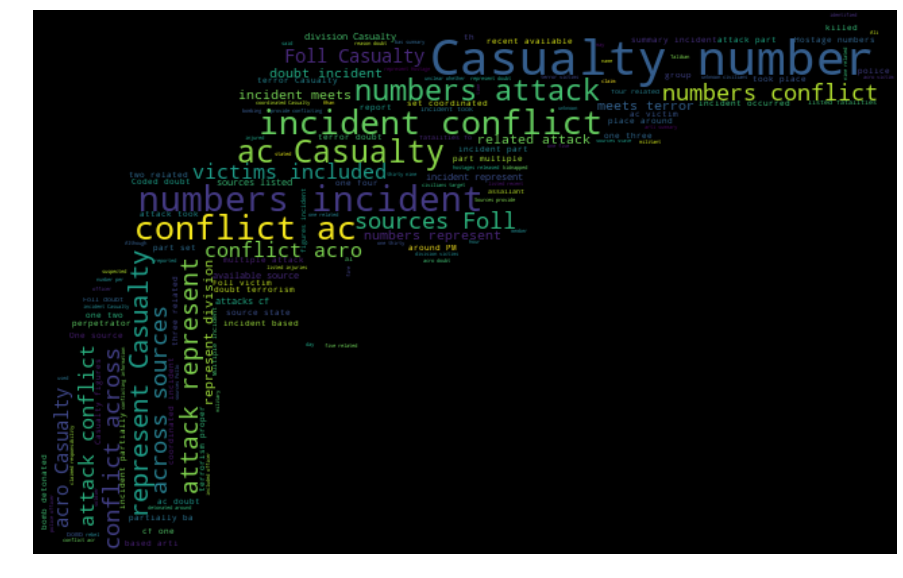

In [13]:
data = data[data['gname']!='Unknown']

### Data wrangling 


d = getcwd()
mask = np.array(Image.open(path.join(d,"mask.png"))) #An image file to mask the wordcloud

#get the word count and making a word count using a mask of a gun to make it more representative
def get_wordcloud(text):
    text = text.dropna()
    text = text.to_string()
    text = re.sub(' +',' ',text)
    wordcloud = WordCloud(background_color="black", max_words=1000, mask=mask).generate(text)
    plt.figure(figsize=(20,10))
    plt.imshow(wordcloud,interpolation='bilinear')
    plt.axis("off")
    plt.margins(x=0,y=0)
    plt.show()

get_wordcloud(data['addnotes'])

### K means clusters


In [14]:
# outlier removal - remove massive terrorist attacks
data = data[data['nkill'] <= 4].reset_index(drop=True)
data = data[data['nwound'] <= 7].reset_index(drop=True)

In [15]:
#select the features need to run kmeans clustering on the dataset 
features = [
    'longitude','latitude','nwound','nkill','natlty1_txt','targtype1_txt','targsubtype1_txt','weaptype1_txt','attacktype1_txt',
]

X = pd.get_dummies(data[features])
X = X.T[X.var() > 0.05].T.fillna(0)
X = X.fillna(0)
print('Shape:', X.shape)
X.head()

Shape: (70385, 22)


,longitude,latitude,nwound,nkill,natlty1_txt_Afghanistan,natlty1_txt_Colombia,natlty1_txt_India,targtype1_txt_Business,targtype1_txt_Government (General),targtype1_txt_Military,...,targsubtype1_txt_Police Security Forces/Officers,weaptype1_txt_Explosives,weaptype1_txt_Firearms,weaptype1_txt_Incendiary,weaptype1_txt_Unknown,attacktype1_txt_Armed Assault,attacktype1_txt_Assassination,attacktype1_txt_Bombing/Explosion,attacktype1_txt_Facility/Infrastructure Attack,attacktype1_txt_Hostage Taking (Kidnapping)
0,-69.951164,18.456792,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
1,-99.086624,19.371887,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
2,-89.176269,37.005105,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,-56.187214,-34.891151,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,-89.412488,43.076592,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


In [16]:
# At this step we will run the kmeand cluster algorithm on our data 
data['Cluster'] = KMeans(n_clusters=2).fit_predict(X) + 1
# the silhouette Score
print('Silhouette Score:', silhouette_score(X, data['Cluster'], sample_size=10000) * 10000 // 1 / 100, '%')

Silhouette Score: 64.71 %


In [17]:
# group by the cluster and keeping the region_txt featutres
names = data.groupby('Cluster')['region_txt'].describe()['top'].values
# set the name of the cluster as the name of majority nodes names
data['ClusterName'] = data['Cluster'].apply(lambda c: names[c - 1])

In [18]:
numerical = data.dtypes[data.dtypes != 'object'].keys()
# Keep only feature we are interested in, drop non numerical
exclude = [
    'eventid', 'Cluster', 'region', 'country', 'iyear', 
    'natlty1', 'natlty2', 'natlty3', 'imonth', 'iday',
    'guncertain1', 'guncertain2', 'guncertain3'
] + [col for col in numerical if 'type' in col or 'mode' in col or 'ransom' in col]
X_profiling = data[numerical.drop(exclude)].fillna(0)
# predicting using Kmeans
X_profiling = pd.DataFrame(scale(X_profiling), columns=X_profiling.columns)
# Updating the cluster name
X_profiling['ClusterName'] = data['ClusterName']

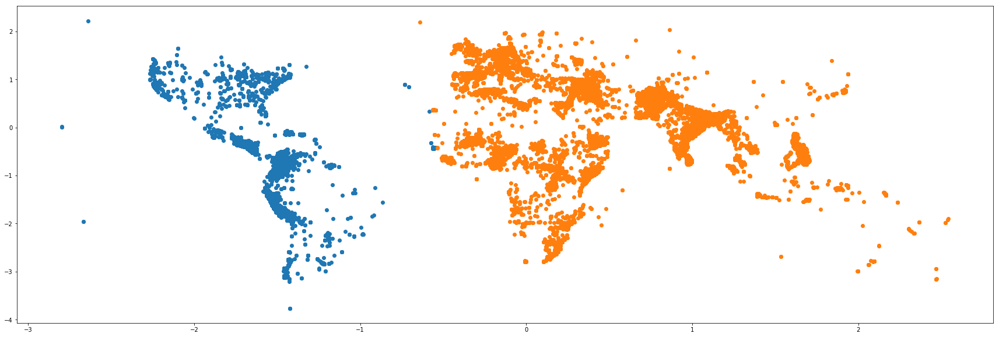

In [19]:
# keep only unique keys
ckeys = data['ClusterName'].unique()
ckeys = dict(zip(ckeys, plt.cm.tab10(range(len(ckeys)))))
plt.figure(figsize=(30,10))
# plot the point using longitude and latitude.
for i, x in X_profiling.groupby('ClusterName'):
    plt.scatter(x['longitude'], x['latitude'], marker='o', cmap='tab10', label=i)

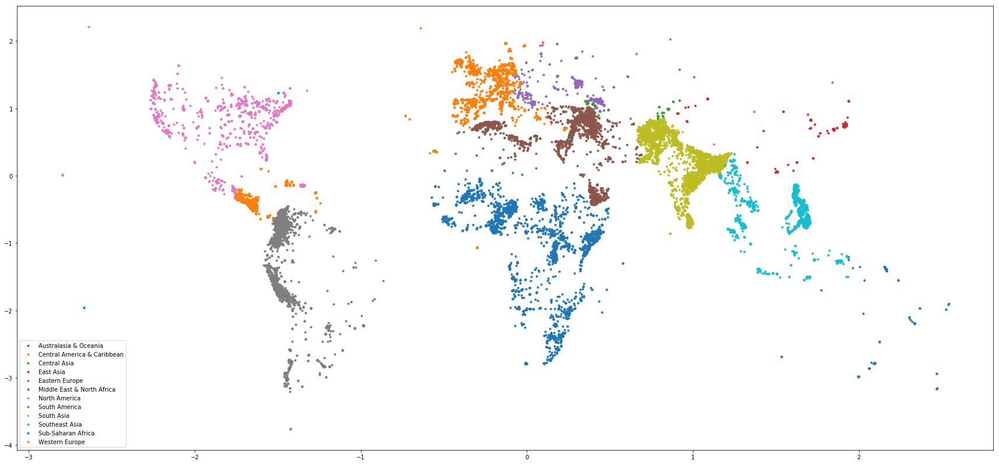

In [20]:
# Now instead of plotting the cluster name let's try kmeans by regions
ckeys = data['region_txt'].unique()
ckeys = dict(zip(ckeys, plt.cm.tab20(range(len(ckeys)))))
plt.figure(figsize=(30,14))
# As above plotting using lon and lat
for i, x in pd.concat([X_profiling, data['region_txt']], axis=1).groupby('region_txt'):
    plt.scatter(x['longitude'], x['latitude'], marker='.', label=i)
# setting the legend
plt.legend(loc=3)

### Network Analysis

### First graph: with related variable which contains a list of related eventid 

In [21]:
# Keep only rows where related is not null
edges = new_data[~new_data.related.isna()]

In [22]:
# Split the list of related eventid 
edges.related = edges.related.apply(lambda x : set(x.replace(' ','').split(',')))
intersect = set(new_data.eventid.apply(lambda x : str(x)))


In [23]:
# Keep only event id that are described in the data
edges.related = edges.related.apply(lambda x : x&intersect)


In [24]:
# Create a dataframe with each edge in a seperate row
# Find all combinations of edges
edges.related = edges.related.apply(lambda x : list(itertools.combinations(x,2)))
edges = edges[['eventid','related']]
df1 = edges.related.apply(pd.Series).stack().rename('related')
df2 = df1.to_frame().reset_index(1, drop=True)
edges = df2.join(edges.eventid).reset_index(drop=True)

In [25]:
edges =  pd.DataFrame(edges['related'].values.tolist(), index=edges.index,columns = {'source','dest'})

In [26]:
weights = edges.reset_index().groupby(['dest','source']).count().reset_index()

In [27]:
# Build graph
related_graph = nx.Graph()
related_graph.add_weighted_edges_from(list(zip(weights['dest'],weights['source'],weights['index'])))

**With the graphistry library, (after requesting a API key) we could have a highly sophiesticated and interactive graph.**

In [28]:
graphistry.register(key='370c9675be7ab15766e38af1906aa8e77a1265cbcf26256dcc1eb6c223e5bf40')
graphistry.nodes(related_graph.nodes()).edges(related_graph.edges()).settings(url_params={'play': 0}).bind(source='src', destination='dst',node='nodeid').plot(related_graph)

In [29]:
all_ = set(edges.dest.unique())
for elem in edges.source.unique():
    all_.add(elem)

In [30]:
new_data['eventid'] = new_data.eventid.apply(lambda x : str(x))

### Spectral clustering on related : to plot 

In [31]:
# Find largest component
giant = max(nx.connected_component_subgraphs(related_graph), key=len)
# Spectral clustring
sc = SpectralClustering(3, affinity='precomputed', n_init=100,assign_labels='discretize')
labels = sc.fit_predict(nx.adjacency_matrix(giant)) 

In [32]:
sc.fit(nx.adjacency_matrix(giant))

SpectralClustering(affinity='precomputed', assign_labels='discretize',
          coef0=1, degree=3, eigen_solver=None, eigen_tol=0.0, gamma=1.0,
          kernel_params=None, n_clusters=3, n_init=100, n_jobs=None,
          n_neighbors=10, random_state=None)

In [33]:
# Set the layout to draw the largest component
pos = nx.layout.spring_layout(giant)


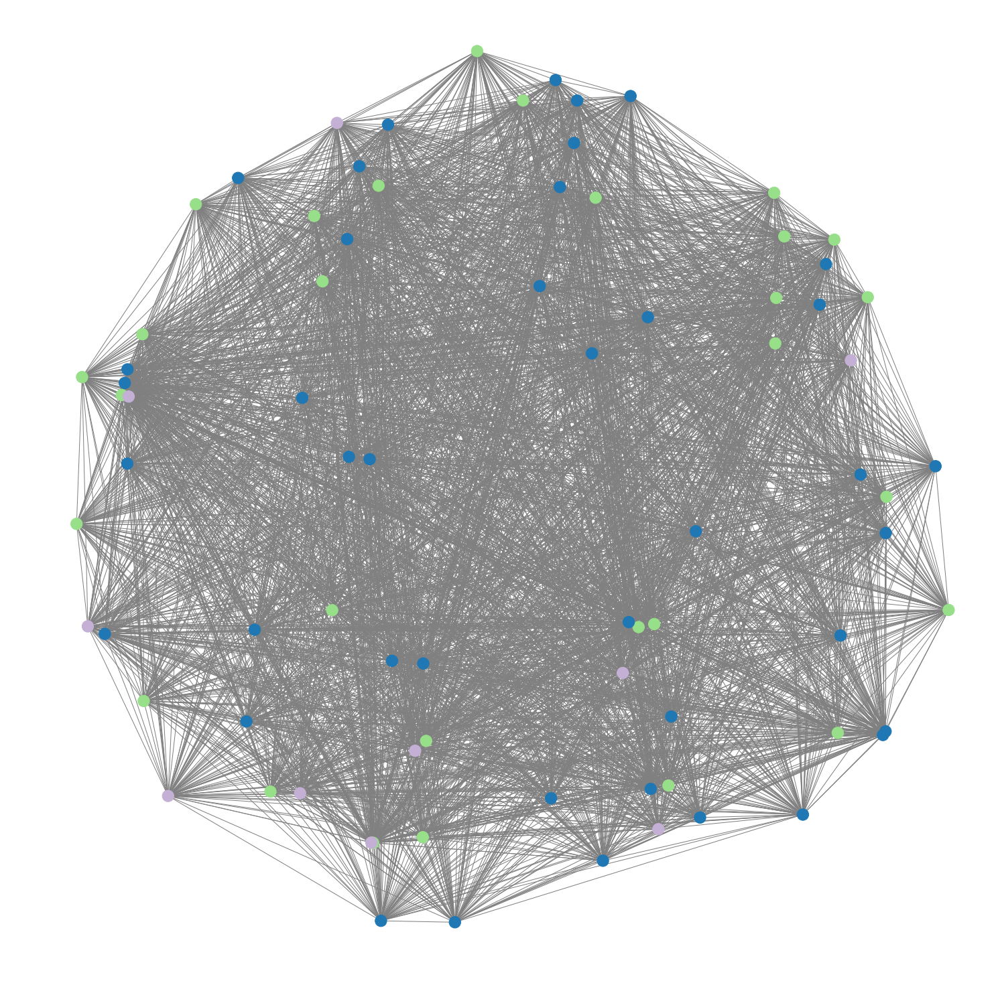

In [34]:
# Set figure size
palette = sns.color_palette(palette='tab20', n_colors=10)#len(10)+1)

plt.figure(figsize=(20, 20))

# Draw the graph with the spectral clustering labels
nx.draw(giant,pos=pos, node_color=sc.labels_,#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       #node_size=(node_size+node_size.mean())*6000,
                       #labels=labels,
               edge_color='grey',
              )


### Second graph: Graph of organizations weighted by common targets


We constructed a bipartite graph with two sets of nodes, the first one represents organizations and the second one represents the targets

In [35]:
# Preparing graph dataframe
graph_df = new_data[~(new_data['targtype1_txt']== 'Unknown') & ~(new_data['gname']== 'Other')][['gname','targtype1_txt']]
target = set(graph_df.targtype1_txt.unique())
G_name = nx.from_pandas_edgelist(graph_df, source = 'gname', target = 'targtype1_txt', create_using = nx.Graph())

In [36]:
# Check if graph is Bipartite
bipartite.is_bipartite(G_name)

True

Bipartite network projection will be used to compress information from our bipartite graph, we will choose the weighting method which will take into account the number of commun targets between organizations

In [37]:
# Wighted projection of the bipartite graph to the set of unique organization names
G_p = bipartite.weighted_projected_graph(G_name,graph_df.gname.unique())

In [38]:
print('Number of nodes = ', G_p.number_of_nodes())
print('Number of edges = ', G_p.number_of_edges())

Number of nodes =  3521
Number of edges =  2471239


**We tried to investigate the network properities in order to get nodes and edges importance.**

In [39]:
# Find Largest component
giant = max(nx.connected_component_subgraphs(G_p), key=len)

**Degree Centrality**

Degree centrality starts with the assumption that the person with the most connections (edges) is the most important. Rather than returning a count it is the degree of the node divided by the total possible number of edges that the node could have. For the case of the directed graph the degree of the incoming vertices and outgoing vertices would likely be treated separately.

In other words centrality algorithms determine a node’s relative importance within a graph by looking at how connected it is to other nodes. It is used for instance to identify key players within organizations.

In [40]:
degree_centrality = nx.degree_centrality(giant)

degree_centrality = sorted(degree_centrality.items(), key = operator.itemgetter(1), reverse = True)

**PageRank**

PageRank computes a ranking of the nodes in the graph G based on the structure of the incoming links. It was originally designed as an algorithm to rank web pages. It make a sens that we use it in our study since we can consider targets as web pages.

In [41]:
pr = nx.pagerank_scipy(giant)
# sort the list of page ranks
pr = sorted(pr.items(), key = operator.itemgetter(1), reverse = True)

Let's plot the first 15 ones according to PR algorithm 

In [42]:
pr[1:15]

[("Kurdistan Workers' Party (PKK)", 0.0011617375233616933),
 ('Tehrik-i-Taliban Pakistan (TTP)', 0.001161737523361693),
 ('Basque Fatherland and Freedom (ETA)', 0.0011568078351625551),
 ('Liberation Tigers of Tamil Eelam (LTTE)', 0.0011568078351625551),
 ('Taliban', 0.0011455442287393283),
 ('Maoists', 0.0011406142662564902),
 ('Al-Shabaab', 0.0011351007373551695),
 ("New People's Army (NPA)", 0.0011351007373551693),
 ('Palestinians', 0.001132336528044716),
 ('Hezbollah', 0.0011302844313972847),
 ('National Liberation Army of Colombia (ELN)', 0.0011301707776281843),
 ('Revolutionary Armed Forces of Colombia (FARC)', 0.0011301707776281843),
 ('Shining Path (SL)', 0.0011301707776281843),
 ('Islamic State of Iraq and the Levant (ISIL)', 0.001128722937631025)]

## Spectral Clustering and community detection

In this part, we will try to use two methods, the first one is spectral clustering and the second one is community detection.

#### Spectral Clustering 

***spectral clustering*** techniques make use of the spectrum (eigenvalues) of the similarity matrix of the data to perform dimensionality reduction before clustering in fewer dimensions. The similarity matrix is provided as an input and consists of a quantitative assessment of the relative similarity of each pair of points in the dataset.

In [43]:
# Spectral clustring
#compute the adjacency matrix
adjacency = nx.adjacency_matrix(giant)
#compute the spectral clusters 
spectral = SpectralClustering()
#we tried with a higher number of clusters but it wasn't that accurate
sc = SpectralClustering(5, affinity='precomputed', n_init=100,assign_labels='discretize')
labels = sc.fit_predict(adjacency) 

   1  ||  2  ||  3  ||  4  ||  5  ||  6  ||  7  ||  8  ||  9  ||  10  ||  11  ||  12  ||  13  ||  14  ||  15  ||  16  ||  17  ||  18  ||  19  ||  20  ||  21  ||  22  ||  23  ||  24  ||  25  ||  26


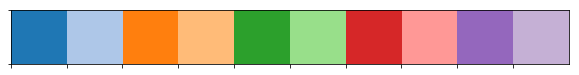

In [44]:
#set colors for the clusters
palette = sns.color_palette(palette='tab20', n_colors=10)#len(10)+1)

sns.palplot(palette)
print('  ', '  ||  '.join([str(i) for i in list(range(1, 26+1))]))

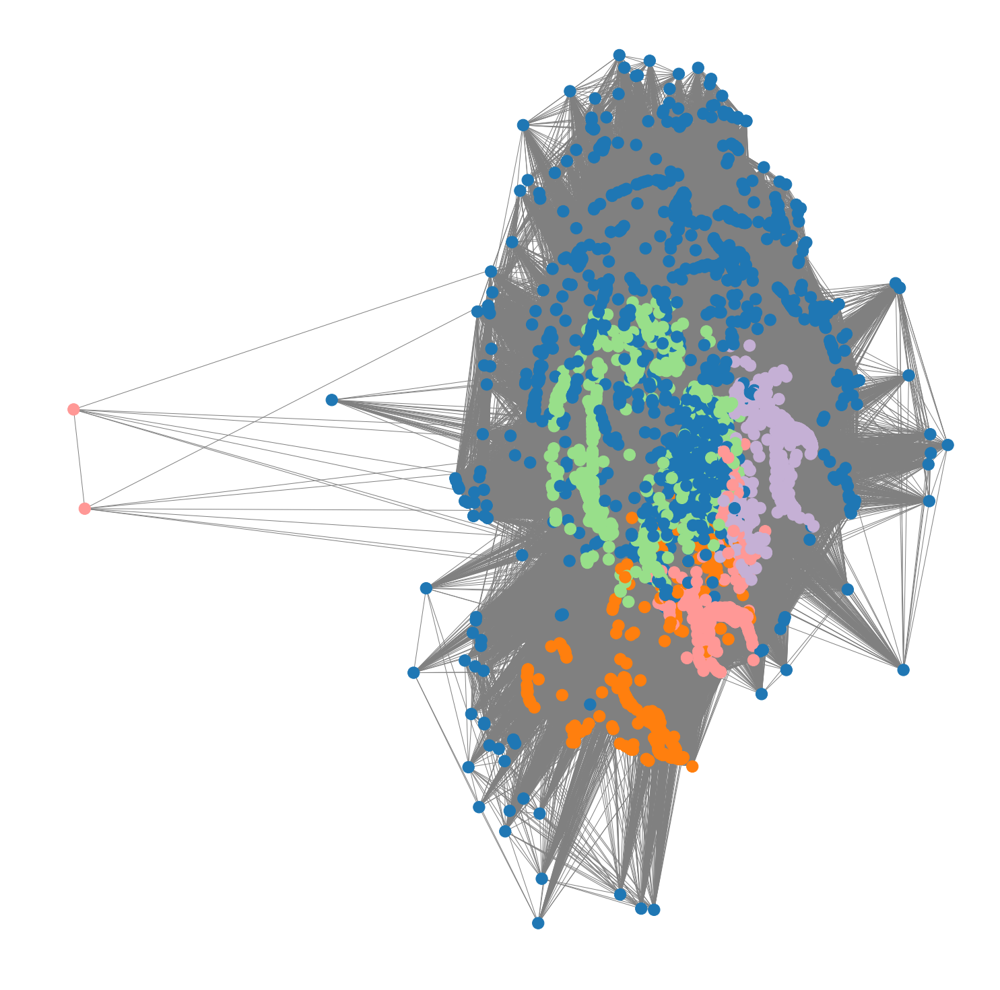

In [45]:
# Visualization of the clusters
pos = nx.layout.spring_layout(giant)
plt.figure(figsize=(20, 20))

nx.draw(giant,pos=pos, node_color=sc.labels_,#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       #node_size=(node_size+node_size.mean())*6000,
                       #labels=labels,
               edge_color='grey',
              )

In [46]:
from tqdm import tqdm 
terrorism = new_data['gname'].unique()
groups = new_data.groupby('gname')
groups_target = dict()
new_data = new_data[new_data['gname']!='Unknown']
new_data = new_data[new_data['gname']!='others']
for elem in terrorism: 
    groups_target[elem]=set(groups.get_group(elem)['targtype1_txt'])

weights =dict()
for g1 in tqdm(terrorism):
    group1 = groups_target[g1]
    for g2 in terrorism:
        intersect_g = group1&groups_target[g2]
        if g1!=g2 and len(intersect_g)> 0: #and (((g2,g1)) not in weights.keys()):
            weights[(g1,g2)] = len(intersect_g)

100%|██████████| 3537/3537 [00:07<00:00, 463.87it/s]


In [47]:
weights_bis = list(map(lambda x : (x[0][0],x[0][1],x[1]),weights.items()))

In [48]:
terrorist_targets = nx.Graph()
terrorist_targets.add_weighted_edges_from(weights_bis)

In [49]:
giant = max(nx.connected_component_subgraphs(terrorist_targets), key=len)

In [50]:
from sklearn.cluster import SpectralClustering
import numpy as np
spectral = SpectralClustering()

   1  ||  2  ||  3  ||  4  ||  5  ||  6  ||  7  ||  8  ||  9  ||  10  ||  11  ||  12  ||  13  ||  14  ||  15  ||  16  ||  17  ||  18  ||  19  ||  20  ||  21  ||  22  ||  23  ||  24  ||  25  ||  26


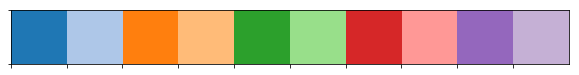

In [51]:
sns.palplot(palette)
print('  ', '  ||  '.join([str(i) for i in list(range(1, 26+1))]))

In [52]:
sc = SpectralClustering(5, affinity='precomputed', n_init=100,
...                         assign_labels='discretize')
labels = sc.fit(nx.adjacency_matrix(giant)) 

#### Community detection using Louvain method 

***The Louvain Method*** for community detection is a method to extract communities from large networks. The inspiration for this method of community detection is the optimization of Modularity as the algorithm progresses. Modularity is a scale value between -1 and 1 that measures the density of edges inside communities to edges outside communities.

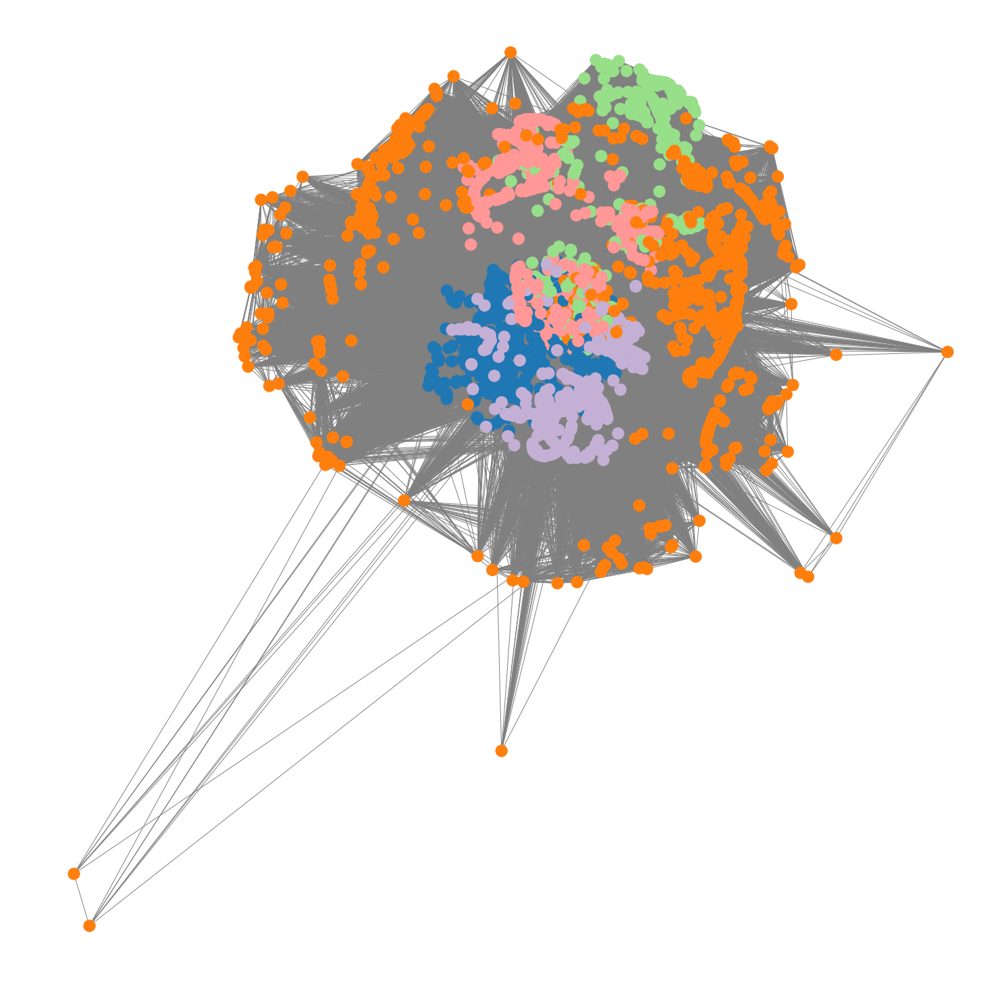

In [53]:
#first compute the best partition
partition = community.best_partition(giant)
pos = nx.layout.spring_layout(giant, seed=2)
plt.figure(figsize=(20, 20))

nx.draw(giant, pos=pos, node_color=pd.Series(partition),#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       #node_size=(node_size+node_size.mean()),
                       #labels=labels,
               edge_color='grey',
               iterations=10)


From the community detection algorithm, we can see that we can not get a real separation between communities. So the spectral clustering algorithm works better on this dataset than the community detection. 

### Plot spectral clustering 


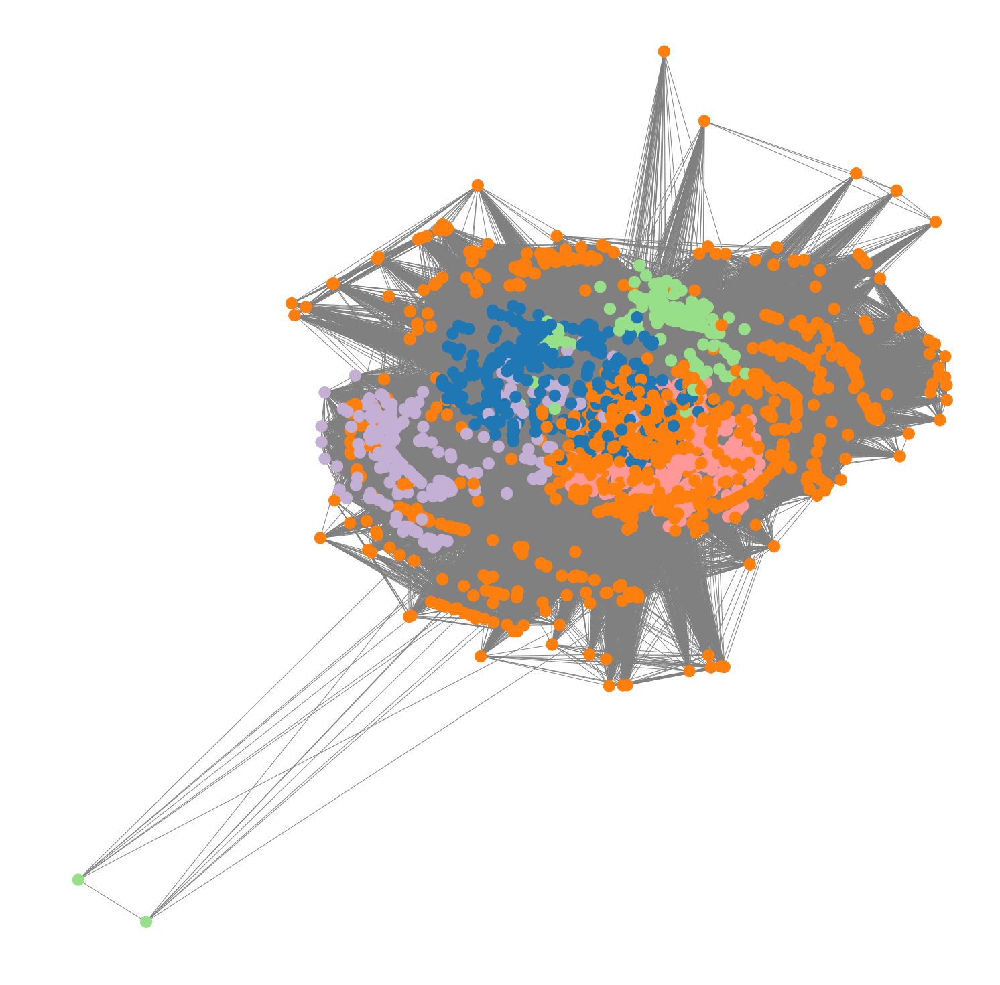

In [54]:
plt.figure(figsize=(20, 20))
palette = sns.color_palette(palette='tab20', n_colors=10)#len(10)+1)

nx.draw(giant, node_color=sc.labels_,#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       #node_size=(node_size+node_size.mean())*6000,
                       #labels=labels,
               edge_color='grey'
              )

### Prediction 

Our purpose in this section is to predict the unknown gnames using Machine learning and the spectral clusters made so far. 

We will split our dataset in two groups, we will take off the unknown gname from the dataset, we will train a random forest classifier on the data that we have using the cluster given by the spectral clustering made in the previous section. 

Then we will check if our algorithm works as good as we want it to, then we will fit on the unknown gname entries and try to assign in which cluster it belongs 

In [55]:
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split

In [57]:
#import the data
data = pd.read_csv('gtd.csv',encoding = 'latin_1')

In [58]:
#create a dictionnary of organisation_name with the clusters that they belong to. 
mapping = dict(zip(giant.nodes(),sc.labels_))

#assign the cluster to each gname of the dataframe if it is in the dictionnary, otherwise assign a nan to it because 
#we don't know to each cluster it belongs
def get_cluster(x):
    try : 
        return mapping[x]
    except KeyError: 
        return np.nan

# filter the dataframe on columns that don't have any missing value
cols = list(missing_value_df[missing_value_df['percent_missing']==0].index)

#Drop the featurs that we do not need for the analysis
features = set(cols)-set(['eventid',
 'iyear',
 'imonth',
 'iday'])
data['target'] = data.gname.apply(lambda x : get_cluster(x))


In [59]:
#create a new dataframe with the valid entries and with the dummy variables for the categorical variables
data_to_predict= data[list(features)]
data_to_predict['target']  = data['target']
X = pd.get_dummies(data_to_predict[~data_to_predict['target'].isna()].drop('gname',axis=1))
X['gname'] = data_to_predict['gname'][~data_to_predict['target'].isna()]
unknowns = X[X['gname']=='Unknown']
X = X[X['gname']!= 'Unknown']
y = X['target']

In [60]:
#split the data into train and test data sets
X_train, X_test, y_train, y_test = train_test_split(X.drop(['target','gname'], axis=1), y, test_size=0.2, random_state=42)
rf = RandomForestClassifier(n_estimators=10, class_weight='balanced')
#function that train, predict and print the accuracy of the model
def predict(model,train,y_train,test,y_test):
    model.fit(train,y_train)
    yhat = model.predict(test)
    print('The accuracy of the model is of: {}'.format(accuracy_score(y_test,yhat)))
predict(rf,X_train, y_train, X_test, y_test)

The accuracy of the model is of: 0.8824183601253665


We are able at 0.882715737324 accuracy to assign each unknown gname to a cluster of gnames that it belongs too. 
The clusters are in the line below. 

In [61]:
rf.fit(X_train,y_train)
unknown_communities = rf.predict(unknowns.drop(['target','gname'],axis = 1))
unknown_communities

array([1, 1, 4, ..., 1, 1, 1])